## Visualization of CNN: Grad-CAM
* **Objective**: Convolutional Neural Networks are widely used on computer vision. It is powerful for processing grid-like data. However we hardly know how and why it works, due to the lack of decomposability into individually intuitive components. In this assignment, we use Grad-CAM, which highlights the regions of the input image that were important for the neural network prediction.

* **To be submitted by next session**: this notebook, **cleaned** (i.e. without results, for file size reasons: `menu > kernel > restart and clean`), in a state ready to be executed (if one just presses 'Enter' till the end, one should obtain all the results for all images) with a few comments at the end. No additional report, just the notebook!

* NB: if `PIL` is not installed, try `conda install pillow`.


In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models, datasets, transforms
import matplotlib.pyplot as plt
import pickle
import urllib.request

import numpy as np
from PIL import Image

%matplotlib inline

### Download the Model
We provide you a pretrained model `ResNet-34` for `ImageNet` classification dataset.
* **ImageNet**: A large dataset of photographs with 1 000 classes.
* **ResNet-34**: A deep architecture for image classification.

In [2]:
resnet34 = models.resnet34(pretrained=True)
resnet34.eval() # set the model to evaluation mode

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

![ResNet34](https://miro.medium.com/max/1050/1*Y-u7dH4WC-dXyn9jOG4w0w.png)

In [3]:
classes = pickle.load(urllib.request.urlopen('https://gist.githubusercontent.com/yrevar/6135f1bd8dcf2e0cc683/raw/d133d61a09d7e5a3b36b8c111a8dd5c4b5d560ee/imagenet1000_clsid_to_human.pkl') )

### Input Images
We provide you 20 images from ImageNet (download link on the webpage of the course or download directly using the following command line,).<br>
In order to use the pretrained model resnet34, the input image should be normalized using `mean = [0.485, 0.456, 0.406]`, and `std = [0.229, 0.224, 0.225]`, and be resized as `(224, 224)`.

In [4]:
def preprocess_image(dir_path):
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])

    dataset = datasets.ImageFolder(dir_path, transforms.Compose([
            transforms.Resize(256), 
            transforms.CenterCrop(224), # resize the image to 224x224
            transforms.ToTensor(), # convert numpy.array to tensor
            normalize])) #normalize the tensor

    return (dataset)

In [5]:
# The images should be in a *sub*-folder of "data/" (ex: data/TP2_images/images.jpg) and *not* directly in "data/"!
# otherwise the function won't find them

import os
os.mkdir("data")
os.mkdir("data/TP2_images")
!cd data/TP2_images && wget "https://www.lri.fr/~gcharpia/deeppractice/2022/TP2/TP2_images.zip" && unzip TP2_images.zip
dir_path = "data/" 
dataset = preprocess_image(dir_path)

--2022-02-02 18:45:51--  https://www.lri.fr/~gcharpia/deeppractice/2022/TP2/TP2_images.zip
Resolving www.lri.fr (www.lri.fr)... 129.175.15.11
Connecting to www.lri.fr (www.lri.fr)|129.175.15.11|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1477062 (1.4M) [application/zip]
Saving to: ‘TP2_images.zip’

TP2_images.zip      100%[===================>]   1.41M  2.53MB/s    in 0.6s    

2022-02-02 18:45:52 (2.53 MB/s) - ‘TP2_images.zip’ saved [1477062/1477062]

Archive:  TP2_images.zip
   creating: .ipynb_checkpoints/
  inflating: 155881293_721e90b57d.jpg  
  inflating: 158850087_3251644046.jpg  
  inflating: 1624593475_146bf1f7ff.jpg  
  inflating: 181748579_01a4611736.jpg  
  inflating: 2068921624_ef0986de13.jpg  
  inflating: 2637374064_fab14ec0b8.jpg  
  inflating: 2749465889_8e62023674.jpg  
  inflating: 2936812850_23bf0d1cfd.jpg  
  inflating: 3532471222_a6d7e3780e.jpg  
  inflating: 3633913271_ee789a3bc4.jpg  
  inflating: 3633949157_f577605ea9.jpg  
  infla

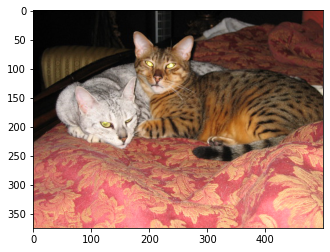

In [6]:
# show the orignal image 
index = 5
input_image = Image.open(dataset.imgs[index][0]).convert('RGB')
plt.imshow(input_image)

In [7]:
output = resnet34(dataset[index][0].view(1, 3, 224, 224))
values, indices = torch.topk(output, 3)
indices = indices.cpu()
values = values.cpu()
print("Top 3-classes:", indices[0].numpy(), [classes[x] for x in indices[0].numpy()])
print("Raw class scores:", values[0].detach().numpy())

Top 3-classes: [285 281 282] ['Egyptian cat', 'tabby, tabby cat', 'tiger cat']
Raw class scores: [13.077121 10.977325 10.554378]


### Grad-CAM 
* **Overview:** Given an image, and a category (‘tiger cat’) as input, we forward-propagate the image through the model to obtain the `raw class scores` before softmax. The gradients are set to zero for all classes except the desired class (tiger cat), which is set to 1. This signal is then backpropagated to the `rectified convolutional feature map` of interest, where we can compute the coarse Grad-CAM localization (blue heatmap).


* **To Do**: Define your own function Grad_CAM to achieve the visualization of the given images. For each image, choose the top-3 possible labels as the desired classes. Compare the heatmaps of the three classes, and conclude. 


* **Hints**: 
 + We need to record the output and grad_output of the feature maps to achieve Grad-CAM. In pytorch, the function `Hook` is defined for this purpose. Read the tutorial of [hook](https://pytorch.org/tutorials/beginner/former_torchies/nnft_tutorial.html#forward-and-backward-function-hooks) carefully. 
 + The pretrained model resnet34 doesn't have an activation function after its last layer, the output is indeed the `raw class scores`, you can use them directly. 
 + The size of feature maps is 7x7, so your heatmap will have the same size. You need to project the heatmap to the resized image (224x224, not the original one, before the normalization) to have a better observation. The function [`torch.nn.functional.interpolate`](https://pytorch.org/docs/stable/nn.functional.html?highlight=interpolate#torch.nn.functional.interpolate) may help.  
 + Here is the link of the paper [Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization](https://arxiv.org/pdf/1610.02391.pdf)

![Grad-CAM](https://da2so.github.io/assets/post_img/2020-08-10-GradCAM/2.png)

Let's define a util function in order to plot images the same way they are input in resnet34

In [8]:
def center_crop(im, new_width, new_height):
  """ Crop the image in the center with the dimensions new_width and new_height
  im: image to crop - Image
  new_width, new_height: Dimensions of the cop - int
  """
  width, height = im.size

  left = (width - new_width)/2
  top = (height - new_height)/2
  right = (width + new_width)/2
  bottom = (height + new_height)/2

  im = im.crop((left, top, right, bottom))
  return im

We want to compute the importance of each pixel for a class c:
- Let's note the output of the classification task $y = (y_c)$
- Consider the last convolutional layer: its activities $A^k_{ij}$ are indexed by pixel location (i,j) and feature number k.
- The importance of feature k for class c is defined by: $a^c_k = \frac{1}{Nb pixels} \sum_{i,j} \frac{∂y_c}{∂A^k_{ij}}$ We can obtain this quantity by averaging the backpropagated gradient of the folowwing quantity: $loss = y_c$. This loss is defined in the function: ```
one_hot_loss(output, target_class) ```
- The heatmap is the importance of the pixel $(i,j)$ described by $\sum_k a^c_k A^k_{ij}$
- The quantity to display is $ReLU(\sum_k a^c_k A^k_{ij})$



In [9]:
def one_hot_loss(output, target_class):
  '''
  output: The output tensor of the model - torch Tensor: 
  class: The class of which we want to compute the importance - int
  '''
  one_hot = torch.zeros(output.size())
  one_hot[0][target_class] = 1
  one_hot.requires_grad = True
  loss = torch.sum(one_hot * output)
  return loss

class Grad_CAM():

  def __init__(self, model, layer):
    """
    Initialise the Grad cam by registering the required hooks.

    model: Model on which we want to compute the Grad Cam - Torch model
    layer: Name of the layer where we want to compute the Grad Cam - str
    """
    self.model = model
    # Register the hook on the last convolutional layer so we can get the gradient and the activities.
    for name, module in model.named_modules():
      if name == layer:
        self.last_conv_layer = module
    self.last_conv_layer.register_backward_hook(self.get_gradient)
    self.last_conv_layer.register_forward_hook(self.get_activation)


  def get_gradient(self, module, grad_input, grad_output):
    self.grad = grad_output[0].detach()


  def get_activation(self, module, input, output):
      self.act = output.detach()


  def get_grad_cam(self, input_image, number_of_maps=3):
    """
    Get the grad cam of the input image for the top "number_of_maps" labels predicted
    input_image: Input image - torch Tensor 
    number_of_maps: Number of heat maps to compute - int 
    """
    Grad_cam_map = {}
    channel, width, height = np.shape(input_image.numpy())
    input = input_image.view(1, channel, width, height)
    output = self.model(input)
    values, indices = torch.topk(output, number_of_maps)
    indices = indices[0].numpy()

    #Loop over the top number of indices we want the heatmap.
    for target_class in indices:
      # Compute the output and the backpropagation to activate the hooks.
      out = self.model(input)
      class_loss = one_hot_loss(out, target_class)
      class_loss.backward()

      #Average the backpropagated quantities
      feature_importance = F.adaptive_avg_pool2d(self.grad, 1)

      # Sum the importance of each pixels over the features
      _, _, width_feature, height_feature = np.shape(self.act.numpy())
      heat_map = torch.mul(self.act, feature_importance).sum(dim=1).view(1,1,width_feature,height_feature)
      
      #Compute ReLU(importance of pixel i,j) so we can display it
      heat_map = F.relu(heat_map)

      #Interpolate the heat map from the feature map to the image size
      heat_map = F.interpolate(heat_map, (width,height), mode='bilinear')
      Grad_cam_map[target_class] = heat_map.numpy().reshape(width,height)
    return Grad_cam_map


In [10]:
resnet34 = models.resnet34(pretrained=True)
resnet34.eval() # set the model to evaluation mode
My_grad_cam = Grad_CAM(model=resnet34, layer="layer4.2")

## Plot all the images and the grad Cams of the top 3 Features

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/module.py:1025: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


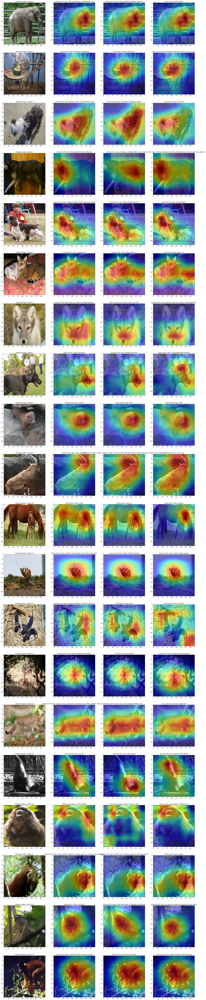

In [11]:
fig, axs = plt.subplots(20,4, figsize=(30,8*20))

for index in range(20):
  Grad_cam_map = My_grad_cam.get_grad_cam(dataset[index][0], 3)
  img = Image.open(dataset.imgs[index][0]).convert('RGB').resize((256,256))
  img = center_crop(img, 224, 224)

  axs[index][0].imshow(img)
  axs[index][0].set_title(f"Original image: number {index}")

  i=1
  for key in Grad_cam_map.keys():
    axs[index][i].imshow(img)
    axs[index][i].imshow(Grad_cam_map[key], alpha=0.5, cmap="jet")
    axs[index][i].set_title(f"Grad cam for class: {classes[key]}")

    i+=1

The GradCAM gives us information on why the model thinks the image is classified as something. With a manual processing we can extract more information on the image. Depending on the setting we can conclude that:
- There are two different objects on the image of different classes. Let's take for example the image of the two dogs (number 7), one on the foreground and one on the background. We see that the model thinks the first one is a Great Dans wheras the other one is a Chesapeake Bay retriever.
- The model is wrong and didn't detect the object we want: Looking at image number 12 we see that the models is trying to classify the background and not the animals on the picture. The prediction wrong.
- The model has detected the right object and the right for the class for the right reason. For example Image number 3 of the dog, the model has detected Norwegian Elkhound because of the recognizable feature on the front of the dog.
- The model is right for the wrong reasons: For example Image number 16 of the titi monkey has the right class. However, the important feature is more the background than the monkey itself. That shows us a bias of the model: a monkey is defined by the background it usually is located in rather than its features.